<a href="https://colab.research.google.com/github/laxxitaasingh/EDA-Women-s-E-Commerce-Review/blob/main/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## EDA


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from textblob import TextBlob
%matplotlib inline

import plotly as py
import cufflinks as cf

In [ ]:
from plotly.offline import iplot

In [ ]:
py.offline.init_notebook_mode(connected=True)
cf.go_offline()

In [ ]:
df=pd.read_csv("D:\Books\Womens Clothing E-Commerce Reviews.csv")

In [ ]:
df.head()

,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [ ]:
df.drop(labels=['Title','Unnamed: 0'],axis = 1 , inplace = True)

In [ ]:
df.head()

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,767,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1080,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,1077,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,1049,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,847,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [ ]:
df.isnull().sum()

Clothing ID                  0
Age                          0
Review Text                845
Rating                       0
Recommended IND              0
Positive Feedback Count      0
Division Name               14
Department Name             14
Class Name                  14
dtype: int64

In [ ]:
df.dropna(subset=['Review Text','Division Name'],inplace = True)

In [ ]:
df.isnull().sum()

Clothing ID                0
Age                        0
Review Text                0
Rating                     0
Recommended IND            0
Positive Feedback Count    0
Division Name              0
Department Name            0
Class Name                 0
dtype: int64

In [ ]:
' '.join(df['Review Text'].tolist())

'Absolutely wonderful - silky and sexy and comfortable Love this dress!  it\'s sooo pretty.  i happened to find it in a store, and i\'m glad i did bc i never would have ordered it online bc it\'s petite.  i bought a petite and am 5\'8".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c I love, love, love this jumpsuit. it\'s fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments! This shirt

# Text cleaning

In [ ]:
contractions = { 
"ain't": "am not / are not / is not / has not / have not",
"aren't": "are not / am not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he had / he would",
"he'd've": "he would have",
"he'll": "he shall / he will",
"he'll've": "he shall have / he will have",
"he's": "he has / he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how has / how is / how does",
"I'd": "I had / I would",
"I'd've": "I would have",
"I'll": "I shall / I will",
"I'll've": "I shall have / I will have",
"I'm": "I am",
"I've": "I have",
"isn't": "is not",
"it'd": "it had / it would",
"it'd've": "it would have",
"it'll": "it shall / it will",
"it'll've": "it shall have / it will have",
"it's": "it has / it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she had / she would",
"she'd've": "she would have",
"she'll": "she shall / she will",
"she'll've": "she shall have / she will have",
"she's": "she has / she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as / so is",
"that'd": "that would / that had",
"that'd've": "that would have",
"that's": "that has / that is",
"there'd": "there had / there would",
"there'd've": "there would have",
"there's": "there has / there is",
"they'd": "they had / they would",
"they'd've": "they would have",
"they'll": "they shall / they will",
"they'll've": "they shall have / they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we had / we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what shall / what will",
"what'll've": "what shall have / what will have",
"what're": "what are",
"what's": "what has / what is",
"what've": "what have",
"when's": "when has / when is",
"when've": "when have",
"where'd": "where did",
"where's": "where has / where is",
"where've": "where have",
"who'll": "who shall / who will",
"who'll've": "who shall have / who will have",
"who's": "who has / who is",
"who've": "who have",
"why's": "why has / why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you had / you would",
"you'd've": "you would have",
"you'll": "you shall / you will",
"you'll've": "you shall have / you will have",
"you're": "you are",
"you've": "you have"
}

In [ ]:
def cont_to_exp(x):
    if type(x) is str:
        x=x.replace('\\', ' ')
        for key in contractions:
            value = contractions[key]
            x=x.replace(key, value)
        return x
    else:
        return x
        

In [ ]:
x = "i don't know what date is today, I am 5'8\""

In [ ]:
print(cont_to_exp(x))

i do not know what date is today, I am 5'8"


In [ ]:
%%time
df['Review Text '] = df['Review Text'].apply(lambda x: cont_to_exp(x))

Wall time: 1.47 s


In [ ]:
' '.join(df['Review Text'].tolist())

'Absolutely wonderful - silky and sexy and comfortable Love this dress!  it\'s sooo pretty.  i happened to find it in a store, and i\'m glad i did bc i never would have ordered it online bc it\'s petite.  i bought a petite and am 5\'8".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c I love, love, love this jumpsuit. it\'s fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments! This shirt

# Feature Engineering

In [ ]:
df['polarity']=df['Review Text'].apply(lambda x: TextBlob(x).sentiment.polarity)

In [ ]:
df['review_len']=df['Review Text'].apply(lambda x: len(x))

In [ ]:
df['word_count']=df['Review Text'].apply(lambda x: len(x.split()))

In [ ]:
def get_avg_word_len(x):
    words = x.split()
    word_len = 0
    for word in words:
        word_len = word_len + len(word)
        
    return word_len/len(words)
    

In [ ]:
df['avg_word_len']= df['Review Text'].apply(lambda x: get_avg_word_len(x))

In [ ]:
df.head()

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,Review Text,polarity,review_len,word_count,avg_word_len
0,767,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,Absolutely wonderful - silky and sexy and comf...,0.633333,53,8,5.750000
1,1080,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses,Love this dress! it has / it is sooo pretty. ...,0.339583,303,62,3.822581
2,1077,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,I had such high hopes for this dress and reall...,0.073675,500,98,4.112245
3,1049,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants,"I love, love, love this jumpsuit. it has / it ...",0.550000,124,22,4.681818
4,847,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,This shirt is very flattering to all due to th...,0.512891,192,36,4.361111


In [ ]:
'''By creating a separate data frame
for Numerical data and Object data you
will get the idea of when we will use the visualization.'''
df_numerical = df.select_dtypes(include=['int64'])
df_categorical = df.select_dtypes(include=['object'])
df_cat = df[['Division Name', 'Department Name','Class Name']]
print("Numerical col: ", df_numerical.columns)
print()
print("Object col: ", df_cat.columns)

Numerical col:  Index(['Clothing ID', 'Age', 'Rating', 'Recommended IND',
       'Positive Feedback Count', 'review_len', 'word_count'],
      dtype='object')

Object col:  Index(['Division Name', 'Department Name', 'Class Name'], dtype='object')


# Distribution of Sentiemnt Polarity

Text(0.5, 1.0, 'Heatmap for Whole Data')

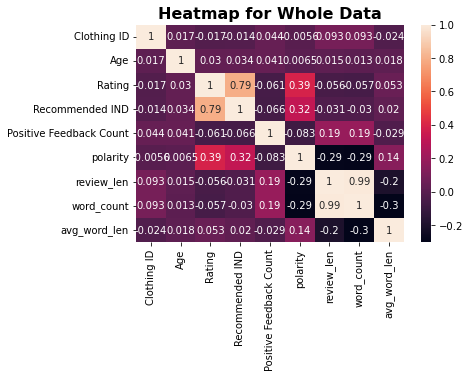

In [ ]:
#annot will help us to present int in heatmap
sns.heatmap(df.corr(), annot=True) 
plt.title('Heatmap for Whole Data', fontsize = 16, fontweight = 'bold')

In [ ]:
df['polarity'].iplot()

In [ ]:
df['polarity'].iplot(kind='hist',colors='blue',bins=100,xTitle='Polarity',yTitle='Count', title="Sentiments Polarity Distribution")

# Distribution of Reviews,Rating and Reviewers age

In [ ]:
df['Rating'].iplot(kind='hist',xTitle='Rating',yTitle='Count',title='Review Rating Distributuin')

In [ ]:
df['Age'].iplot(kind='hist',bins=40,xTitle ='Age',yTitle='Count',title='Reviewers Age Dist',colors='pink')

# Distribution of Review Text Length and Word Length 

In [ ]:
df['review_len'].iplot(kind='hist',xTitle='Review len',yTitle='Count',title='Review Text Len Dist',colors='aqua')

In [ ]:
df['word_count'].iplot(kind='hist',xTitle='Word count',yTitle='Count',title='Word count Len Dist',colors='black')

In [ ]:
df['avg_word_len'].iplot(kind='hist',xTitle='Word len',yTitle='Count',bins=40,title='Avg Word Text Len Dist',colors='Magenta')

# Distribution of Department, Division and Class

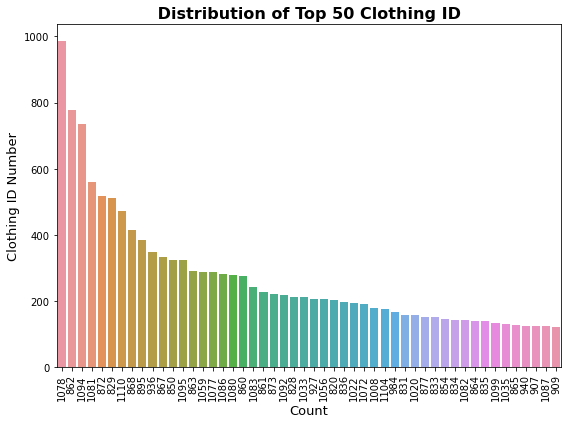

In [ ]:
plt.figure(figsize=(8,6))
ax = sns.countplot(x='Clothing ID', data = df, 
                   order = df['Clothing ID'].value_counts().index[:50])
plt.title(' Distribution of Top 50 Clothing ID ', fontsize = 16, fontweight = 'bold')
plt.xlabel('Count', fontsize = 13)
plt.xticks(rotation=90)
plt.ylabel('Clothing ID Number', fontsize = 13)
plt.tight_layout()
plt.show()

In [ ]:
df['Department Name'].value_counts()

Tops        10048
Dresses      6145
Bottoms      3662
Intimate     1653
Jackets      1002
Trend         118
Name: Department Name, dtype: int64

In [ ]:
df.groupby('Department Name').count()

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Class Name,Review Text,polarity,review_len,word_count,avg_word_len
Department Name,,,,,,,,,,,,,
Bottoms,3662,3662,3662,3662,3662,3662,3662,3662,3662,3662,3662,3662,3662
Dresses,6145,6145,6145,6145,6145,6145,6145,6145,6145,6145,6145,6145,6145
Intimate,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653
Jackets,1002,1002,1002,1002,1002,1002,1002,1002,1002,1002,1002,1002,1002
Tops,10048,10048,10048,10048,10048,10048,10048,10048,10048,10048,10048,10048,10048
Trend,118,118,118,118,118,118,118,118,118,118,118,118,118


In [ ]:
df['Department Name'].value_counts().iplot(yTitle='Count',xTitle='Department',title='Line Chart of Department Name')

In [ ]:
df['Division Name'].value_counts().iplot(yTitle='Count',xTitle='Division',title='Line Chart of Department Name',colors='purple')

# Distribution of Unigram, Bigram and Trigram

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
x=['this is the list list this']

In [ ]:

vec = CountVectorizer().fit(x)
bow = vec.transform(x)
sum_words = bow.sum(axis=0)
words_freq =[ (word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
words_freq = sorted(words_freq,key = lambda x: x[1],reverse=True)
 

## Unigram

In [ ]:
def get_top_n_words(x,n):
    
    vec = CountVectorizer(ngram_range=(1,1)).fit(x)
    bow = vec.transform(x)
    sum_words = bow.sum(axis=0)
    words_freq =[ (word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq,key = lambda x: x[1],reverse=True)
    return words_freq[:n]

In [ ]:
get_top_n_words(x,3)

[('this', 2), ('list', 2), ('is', 1)]

In [ ]:
words= get_top_n_words(df['Review Text'],20)

In [ ]:
words

[('the', 76158),
 ('it', 49273),
 ('and', 48993),
 ('is', 30636),
 ('this', 25758),
 ('to', 24577),
 ('in', 20722),
 ('but', 16549),
 ('on', 15325),
 ('for', 13994),
 ('of', 13427),
 ('with', 12797),
 ('was', 12220),
 ('so', 12017),
 ('my', 11027),
 ('dress', 10567),
 ('that', 10011),
 ('not', 9796),
 ('love', 8945),
 ('size', 8770)]

In [ ]:
df1= pd.DataFrame(words,columns=['Unigram','Frequency'])
df1=df1.set_index('Unigram')
df1.iplot(kind='bar',colors='blueviolet',xTitle='Unigram',yTitle='Count',title='Top 20 unigram words')

## Bigram

In [ ]:
def get_top_n_words(x,n):
    
    vec = CountVectorizer(ngram_range=(2,2)).fit(x)
    bow = vec.transform(x)
    sum_words = bow.sum(axis=0)
    words_freq =[ (word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq,key = lambda x: x[1],reverse=True)
    return words_freq[:n]

In [ ]:
get_top_n_words(x,3)

[('this is', 1), ('is the', 1), ('the list', 1)]

In [ ]:
words= get_top_n_words(df['Review Text'],20)

In [ ]:
df1= pd.DataFrame(words,columns=['Bigram','Frequency'])
df1=df1.set_index('Bigram')
df1.iplot(kind='bar',colors='salmon',xTitle='Bigram',yTitle='Count',title='Top 20 Bigram words')

## Trigram

In [ ]:
def get_top_n_words(x,n):
    
    vec = CountVectorizer(ngram_range=(3,3)).fit(x)
    bow = vec.transform(x)
    sum_words = bow.sum(axis=0)
    words_freq =[ (word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq,key = lambda x: x[1],reverse=True)
    return words_freq[:n]

In [ ]:
get_top_n_words(x,3)

[('this is the', 1), ('is the list', 1), ('the list list', 1)]

In [ ]:
words= get_top_n_words(df['Review Text'],20)

In [ ]:
df1= pd.DataFrame(words,columns=['Trigram','Frequency'])
df1=df1.set_index('Trigram')
df1.iplot(kind='bar',colors='lightpink',xTitle='Trigram',yTitle='Count',title='Top 20 Trigram words')

# Distribution of Top 20 Parts-of-Speech POS tags

In [ ]:
import nltk

In [ ]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('tagsets')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\LAXITA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\LAXITA\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package tagsets to
[nltk_data]     C:\Users\LAXITA\AppData\Roaming\nltk_data...
[nltk_data]   Package tagsets is already up-to-date!


True

In [ ]:
print(nltk.help.upenn_tagset())

$: dollar
    $ -$ --$ A$ C$ HK$ M$ NZ$ S$ U.S.$ US$
'': closing quotation mark
    ' ''
(: opening parenthesis
    ( [ {
): closing parenthesis
    ) ] }
,: comma
    ,
--: dash
    --
.: sentence terminator
    . ! ?
:: colon or ellipsis
    : ; ...
CC: conjunction, coordinating
    & 'n and both but either et for less minus neither nor or plus so
    therefore times v. versus vs. whether yet
CD: numeral, cardinal
    mid-1890 nine-thirty forty-two one-tenth ten million 0.5 one forty-
    seven 1987 twenty '79 zero two 78-degrees eighty-four IX '60s .025
    fifteen 271,124 dozen quintillion DM2,000 ...
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
EX: existential there
    there
FW: foreign word
    gemeinschaft hund ich jeux habeas Haementeria Herr K'ang-si vous
    lutihaw alai je jour objets salutaris fille quibusdam pas trop Monte
    terram fiche oui corporis ...
IN: preposition or

In [ ]:
print(str(df['Review Text']))

0        Absolutely wonderful - silky and sexy and comf...
1        Love this dress!  it's sooo pretty.  i happene...
2        I had such high hopes for this dress and reall...
3        I love, love, love this jumpsuit. it's fun, fl...
4        This shirt is very flattering to all due to th...
                               ...                        
23481    I was very happy to snag this dress at such a ...
23482    It reminds me of maternity clothes. soft, stre...
23483    This fit well, but the top was very see throug...
23484    I bought this dress for a wedding i have this ...
23485    This dress in a lovely platinum is feminine an...
Name: Review Text, Length: 22628, dtype: object


In [ ]:
blob = TextBlob(str(df['Review Text']))

In [ ]:
pos_df=pd.DataFrame(blob.tags,columns=['words','pos'])
pos_df=pos_df['pos'].value_counts()
pos_df


NN     25
DT     15
JJ     12
CD     11
PRP     8
RB      6
VBZ     5
IN      5
CC      4
NNP     4
VBD     4
VBP     4
TO      3
NNS     2
VB      2
PDT     1
Name: pos, dtype: int64

In [ ]:
pos_df.iplot(kind='bar',colors='hotpink'
            )

# Bivariate Analysis


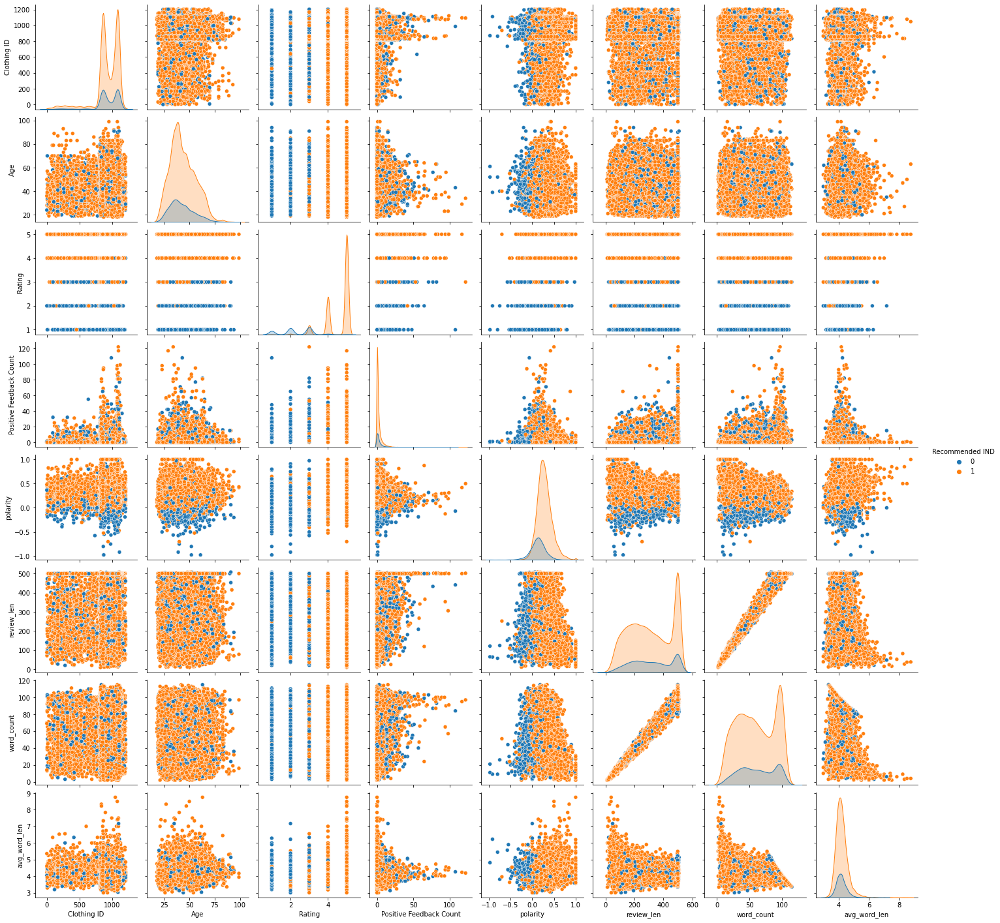

In [ ]:
sns.pairplot(df, hue='Recommended IND')

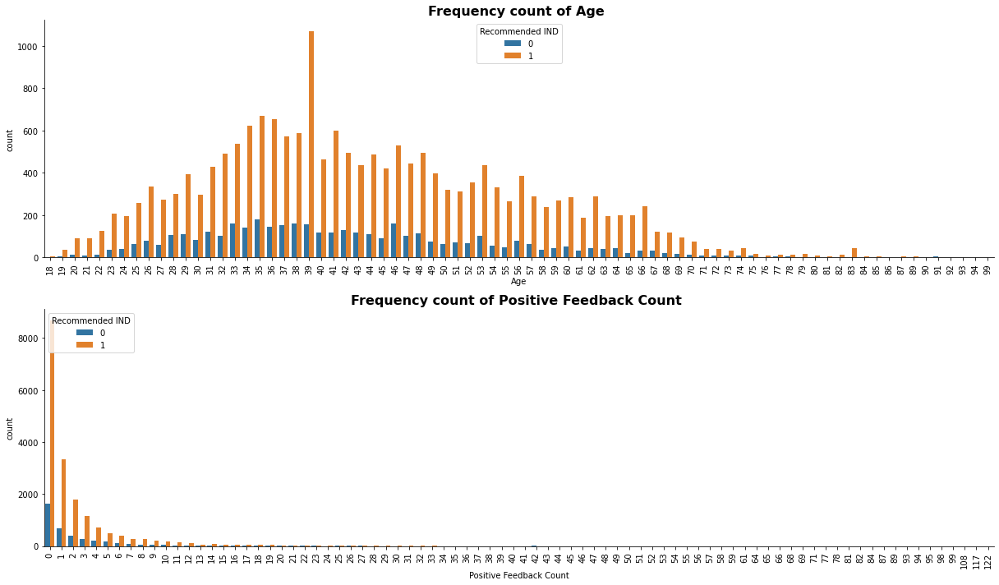

In [ ]:
#Age, Positive Feedback Count Vs Recommended IND
plt.figure(figsize=[17,10])
n=1
label = df[['Age', 'Positive Feedback Count']]
for x in label:
    plt.subplot(2,1,n)
    sns.countplot(x=df[x], hue='Recommended IND',data=df)
    sns.despine()
    plt.title("Frequency count of {} ".format(x), fontsize=16, fontweight='bold')
    plt.xticks(rotation=90)
    n=n+1
plt.tight_layout()
plt.show()

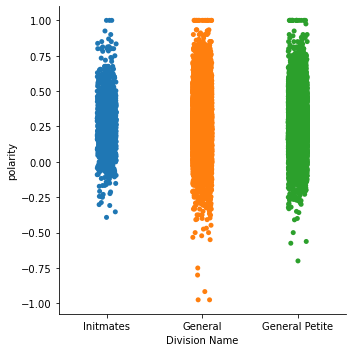

In [ ]:
sns.catplot(x='Division Name',y='polarity',data=df)

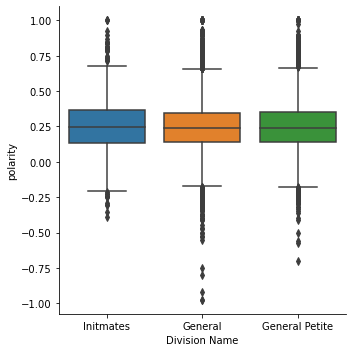

In [ ]:
sns.catplot(x='Division Name',y='polarity',data=df,kind='box')

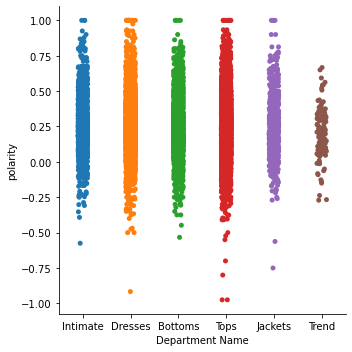

In [ ]:
sns.catplot(x='Department Name',y='polarity',data=df)

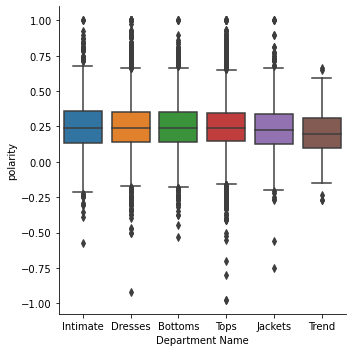

In [ ]:
sns.catplot(x='Department Name',y='polarity',data=df,kind='box')

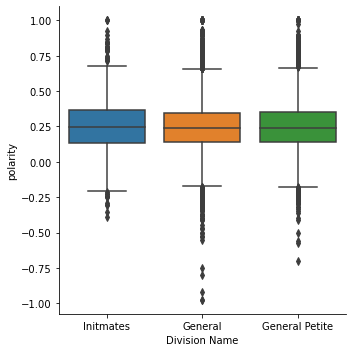

In [ ]:
sns.catplot(x='Division Name',y='polarity',data=df,kind='box')

In [ ]:
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
x1 = df[df['Recommended IND']==1]['polarity']
x0 = df[df['Recommended IND']==0]['polarity']
type(x1)

pandas.core.series.Series

In [ ]:
trace1= go.Histogram(x=x0,name = 'Not Recommended',opacity=0.8)
trace2= go.Histogram(x=x1,name = ' Recommended',opacity=0.8)


In [ ]:
data=[trace1,trace2]
layout=go.Layout(barmode='overlay',title='Sentiment polarity')
fig=go.Figure(data=data,layout=layout)
fig.show()

# Distribution of Ratings Based on the Recommendation


In [ ]:
x1 = df[df['Recommended IND']==1]['Rating']
x0 = df[df['Recommended IND']==0]['Rating']
type(x1)

pandas.core.series.Series

In [ ]:
trace1= go.Histogram(x=x0,name = 'Not Recommended',opacity=0.7)
trace2= go.Histogram(x=x1,name = ' Recommended',opacity=0.7)


In [ ]:
data=[trace1,trace2]
layout=go.Layout(barmode='overlay',title='Sentiment polarity')
fig=go.Figure(data=data,layout=layout)
iplot(fig)

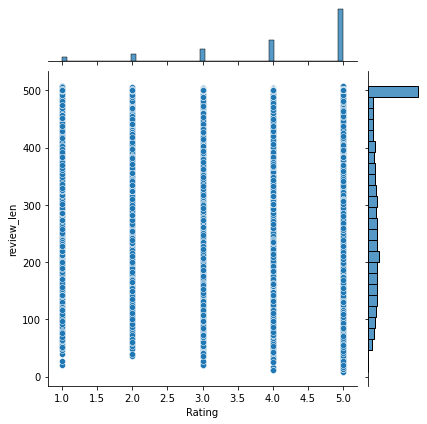

In [ ]:
sns.jointplot(x='Rating',y='review_len',data=df)

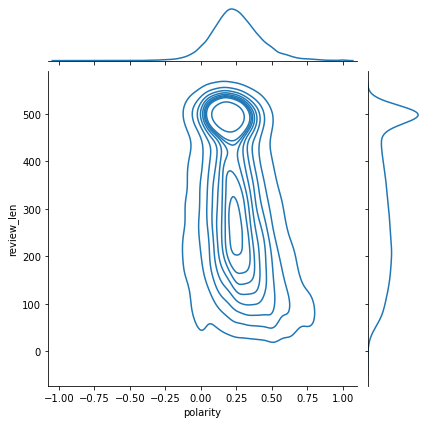

In [ ]:
sns.jointplot(x='polarity',y='review_len',data=df,kind='kde')

# Univariate visualization

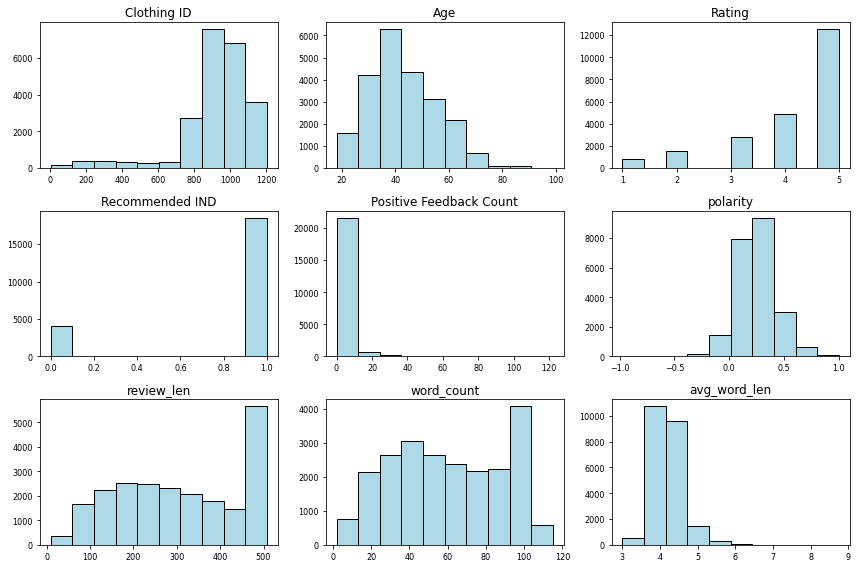

In [ ]:
df.hist(bins=10, color='lightblue', edgecolor='black', linewidth=1.0,
           xlabelsize=8, ylabelsize=8, grid=False)    
plt.tight_layout(rect=(0, 0, 2, 2))

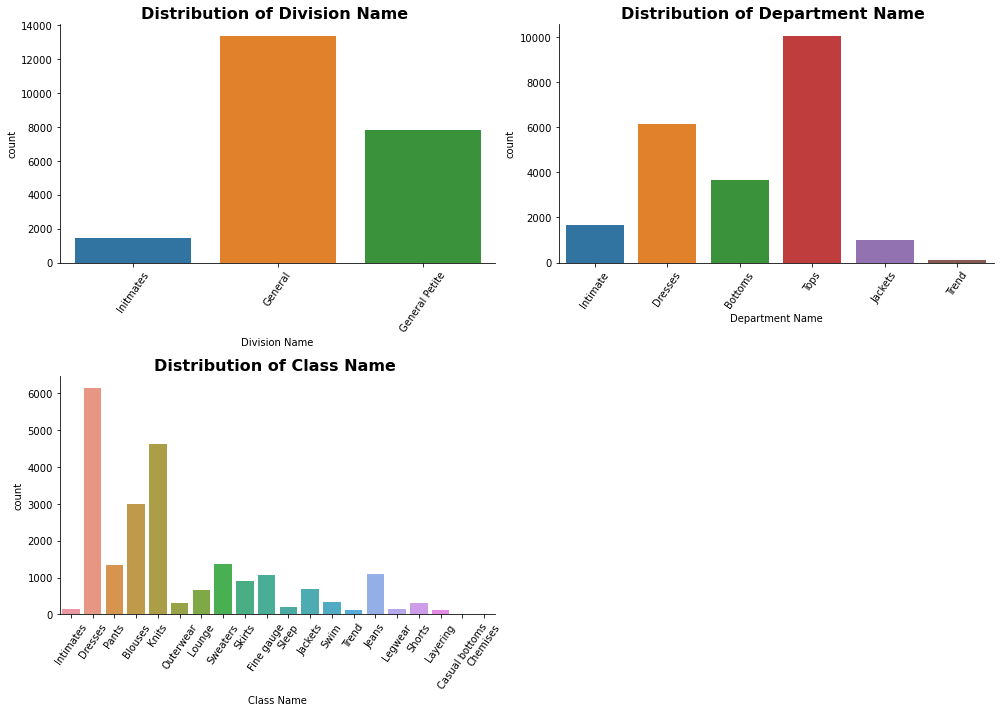

In [ ]:
plt.figure(figsize=[14,10])
n=1
for x in df_cat:
    plt.subplot(2,2,n)
    sns.countplot(x=df[x],data=df)
    sns.despine()
    plt.title("Distribution of {} ".format(x), fontsize=16, fontweight='bold')
    plt.xticks(rotation=55)
    n=n+1
plt.tight_layout()
plt.show()

In [ ]:
df.head()

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,Review Text,polarity,review_len,word_count,avg_word_len
0,767,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,Absolutely wonderful - silky and sexy and comf...,0.633333,53,8,5.750000
1,1080,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses,Love this dress! it has / it is sooo pretty. ...,0.339583,303,62,3.822581
2,1077,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,I had such high hopes for this dress and reall...,0.073675,500,98,4.112245
3,1049,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants,"I love, love, love this jumpsuit. it has / it ...",0.550000,124,22,4.681818
4,847,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,This shirt is very flattering to all due to th...,0.512891,192,36,4.361111


# Division, Department & Class Name Vs Rating

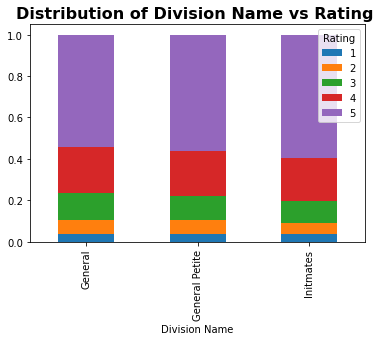

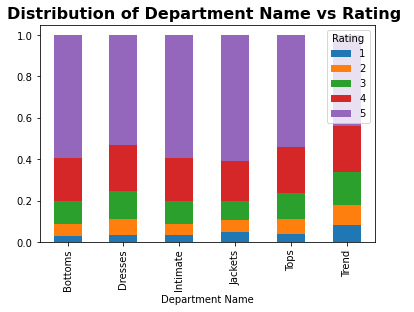

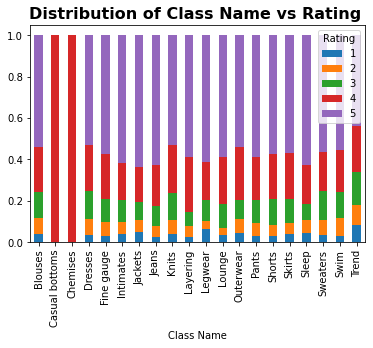

In [ ]:
for x in df_cat:
    y = pd.crosstab(df[x],df['Rating'])
    y.div(y.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
    plt.title("Distribution of {} vs Rating ".format(x), fontsize=16, fontweight='bold')

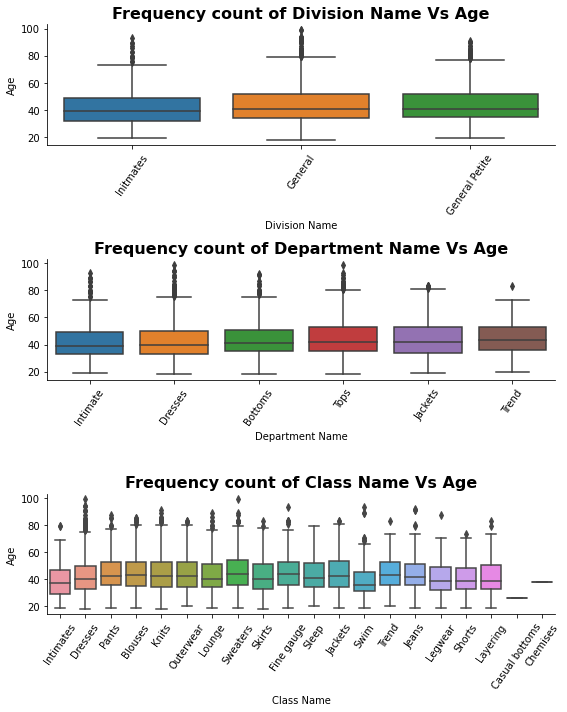

In [ ]:
plt.figure(figsize=[8,10])
n=1
for x in df_cat:
    plt.subplot(3,1,n)
    sns.boxplot(x=df[x], y='Age',data=df)
    sns.despine()
    plt.title("Frequency count of {} Vs Age".format(x), fontsize=16, fontweight='bold')
    plt.xticks(rotation=55)
    n=n+1
plt.tight_layout()
plt.show()

### Division, Department & Class Name Vs Division, Department & Class Name

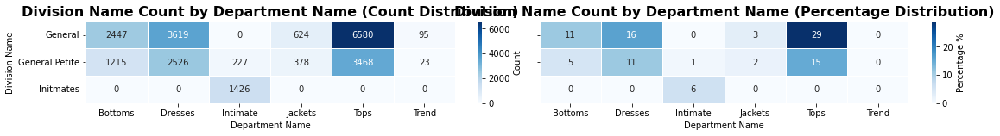

In [ ]:
f, ax = plt.subplots(1,2,figsize=(16, 2), sharey=True)
sns.heatmap(pd.crosstab(df['Division Name'], df["Department Name"]),
            annot=True, linewidths=.5, ax = ax[0],fmt='g', cmap="Blues",
                cbar_kws={'label': 'Count'})
ax[0].set_title('Division Name Count by Department Name (Count Distribution)', fontsize=16, fontweight='bold')
sns.heatmap(pd.crosstab(df['Division Name'], df["Department Name"], normalize=True).mul(100).round(0),
            annot=True, linewidths=.5, ax=ax[1],fmt='g', cmap="Blues",
                cbar_kws={'label': 'Percentage %'})
ax[1].set_title('Division Name Count by Department Name (Percentage Distribution)', fontsize=16, fontweight='bold')
ax[1].set_ylabel('')
plt.tight_layout(pad=0)
plt.show()

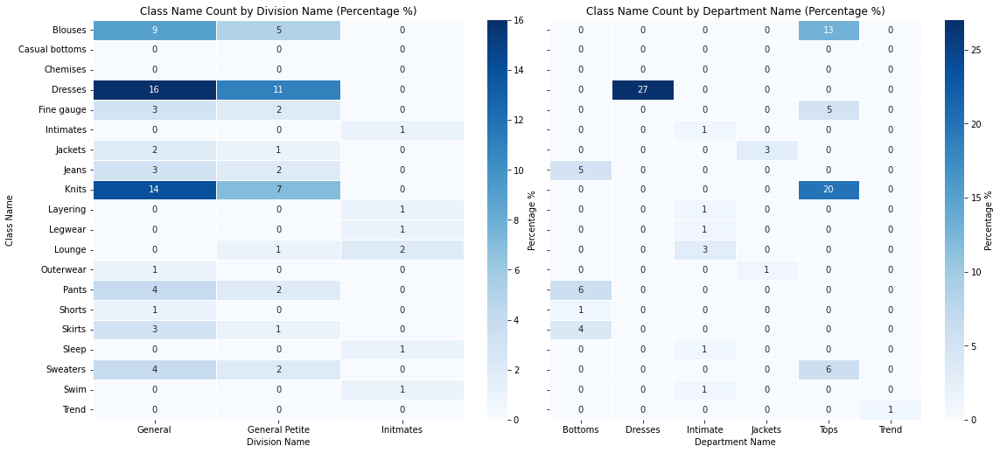

In [ ]:
f, ax = plt.subplots(1,2,figsize=(16, 7), sharey=True)
sns.heatmap(pd.crosstab(df['Class Name'], df["Division Name"], normalize=True).mul(100).round(0),
            annot=True, linewidths=.5, ax = ax[0],fmt='g', cmap="Blues",
                cbar_kws={'label': 'Percentage %'})
ax[0].set_title('Class Name Count by Division Name (Percentage %)')
sns.heatmap(pd.crosstab(df['Class Name'], df["Department Name"], normalize=True).mul(100).round(0),
            annot=True, linewidths=.5, ax=ax[1],fmt='g', cmap="Blues",
                cbar_kws={'label': 'Percentage %'})
ax[1].set_title('Class Name Count by Department Name (Percentage %)')
ax[1].set_ylabel('')
plt.tight_layout(pad=0)
plt.show()

# Sentiment Analysis

In [ ]:
# library for Sentiment Analysis
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.sentiment.util import *
# Sentiment Analysis
SIA = SentimentIntensityAnalyzer()
df["Review Text"]= df["Review Text"].astype(str)
# Applying Model, Variable Creation
df['Polarity Score']=df["Review Text"].apply(lambda x:SIA.polarity_scores(x)['compound'])
df['Neutral Score']=df["Review Text"].apply(lambda x:SIA.polarity_scores(x)['neu'])
df['Negative Score']=df["Review Text"].apply(lambda x:SIA.polarity_scores(x)['neg'])
df['Positive Score']=df["Review Text"].apply(lambda x:SIA.polarity_scores(x)['pos'])
# Converting 0 to 1 Decimal Score to a Positive, Negative, Neutral Variable
df['Sentiment']=''
df.loc[df['Polarity Score']>0,'Sentiment']='Positive'
df.loc[df['Polarity Score']==0,'Sentiment']='Neutral'
df.loc[df['Polarity Score']<0,'Sentiment']='Negative'
df[['Polarity Score', 'Neutral Score', 'Negative Score', 'Positive Score', 'Sentiment']][:3]

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\LAXITA\AppData\Roaming\nltk_data...


,Polarity Score,Neutral Score,Negative Score,Positive Score,Sentiment
0,0.8932,0.272,0.000,0.728,Positive
1,0.9729,0.664,0.000,0.336,Positive
2,0.9427,0.792,0.027,0.181,Positive


Text(0.5, 1.0, 'Distribution of Sentiment vs Recommended IND')

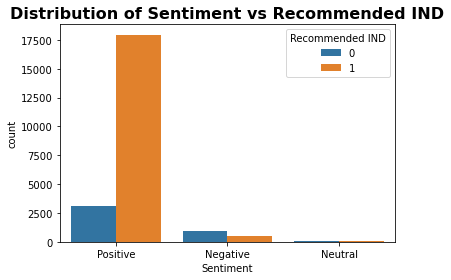

In [ ]:
sns.countplot(x='Sentiment', hue='Recommended IND', data=df)
plt.title("Distribution of Sentiment vs Recommended IND".format(x), fontsize=16, fontweight='bold')

Text(0.5, 1.0, 'Distribution of Sentiment vs Rating')

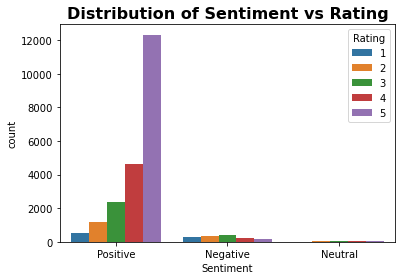

In [ ]:
sns.countplot(x='Sentiment', hue='Rating',data=df)   
plt.title("Distribution of Sentiment vs Rating".format(x), fontsize=16, fontweight='bold')

Text(0.5, 1.0, 'Distribution of Sentiment vs Rating')

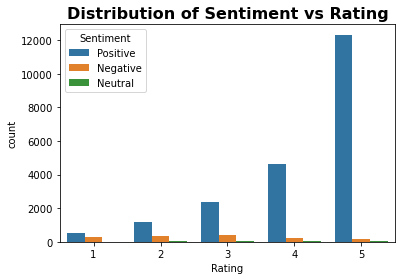

In [ ]:
sns.countplot(x='Rating', hue='Sentiment',data=df)   
plt.title("Distribution of Sentiment vs Rating".format(x), fontsize=16, fontweight='bold')

Text(0.5, 1.0, 'Distribution of Sentiment vs Division Name')

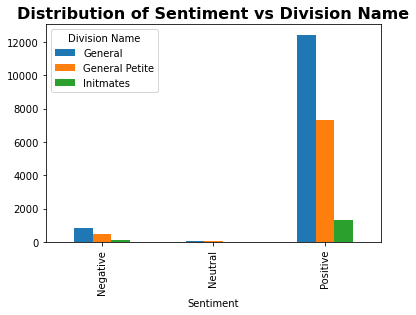

In [ ]:
pd.crosstab(df['Sentiment'], df['Division Name']).plot(kind='bar')
plt.title('Distribution of Sentiment vs Division Name', fontweight='bold', fontsize=16)

Text(0.5, 1.0, 'Distribution of Sentiment vs Department Name')

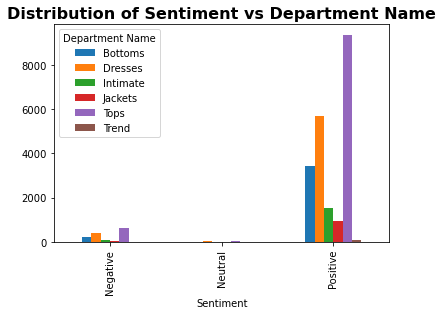

In [ ]:
pd.crosstab(df['Sentiment'], df['Department Name']).plot(kind='bar')
plt.title('Distribution of Sentiment vs Department Name', fontweight='bold', fontsize=16)

Text(0.5, 1.0, 'Distribution of Sentiment vs Class Name')

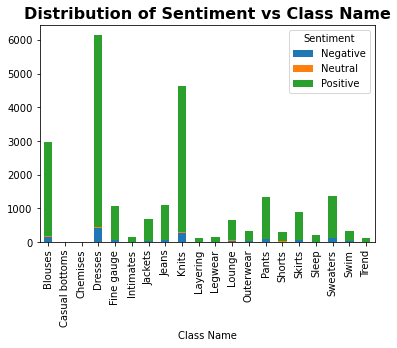

In [ ]:
x = pd.crosstab(df['Class Name'], df['Sentiment'])
x.plot(kind='bar',stacked=True)
plt.title('Distribution of Sentiment vs Class Name', fontweight='bold', fontsize=16)

In [ ]:
jupyter notebook list

SyntaxError: invalid syntax (Temp/ipykernel_17884/1373106854.py, line 1)